In [11]:
## Pawel Maczuga and Maciej Paszynski 2023

import numpy as np
import torch

from datetime import datetime
from torch import nn
from typing import Callable, Tuple
from utils import get_initial_points, plot_intial_condition, plot_simulation_by_frame, create_gif, ReportContext, create_report, plot_running_average

In [12]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [51]:
RUN_NUM = 6

### Parameters

In [52]:
LENGTH = 2. # Domain size in x axis. Always starts at 0
TOTAL_TIME = .5 # Domain size in t axis. Always starts at 0
N_POINTS = 15 # Number of in single asxis
N_POINTS_PLOT = 150 # Number of points in single axis used in plotting

WEIGHT_RESIDUAL = 0.01 # Weight of residual part of loss function
WEIGHT_INITIAL = 2.5 # Weight of initial part of loss function
WEIGHT_BOUNDARY = 0.0005 # Weight of boundary part of loss function

# Original
# WEIGHT_RESIDUAL = 0.03 # Weight of residual part of loss function
# WEIGHT_INITIAL = 1.0 # Weight of initial part of loss function
# WEIGHT_BOUNDARY = 0.0005 # Weight of boundary part of loss function

LAYERS = 6
NEURONS_PER_LAYER = 240
EPOCHS = 100_000
LEARNING_RATE = 0.00015
GRAVITY=9.81

## PINN

In [53]:
class PINN(nn.Module):
    """Simple neural network accepting two features as input and returning a single output

    In the context of PINNs, the neural network is used as universal function approximator
    to approximate the solution of the differential equation
    """
    def __init__(self, num_hidden: int, dim_hidden: int, act=nn.Tanh()):

        super().__init__()

        self.layer_in = nn.Linear(3, dim_hidden)
        self.layer_out = nn.Linear(dim_hidden, 1)

        num_middle = num_hidden - 1
        self.middle_layers = nn.ModuleList(
            [nn.Linear(dim_hidden, dim_hidden) for _ in range(num_middle)]
        )
        self.act = act

    def forward(self, x, y, t):
        x_stack = torch.cat([x, y, t], dim=1).to(self.device())
        out = self.act(self.layer_in(x_stack))
        for layer in self.middle_layers:
            out = self.act(layer(out))
        logits = self.layer_out(out)
        return logits

    def device(self):
        return next(self.parameters()).device


def f(pinn: PINN, x: torch.Tensor, y: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
    """Compute the value of the approximate solution from the NN model"""
    return pinn(x, y, t)


def df(output: torch.Tensor, input: torch.Tensor, order: int = 1) -> torch.Tensor:
    """Compute neural network derivative with respect to input features using PyTorch autograd engine"""
    df_value = output
    for _ in range(order):
        df_value = torch.autograd.grad(
            df_value,
            input,
            grad_outputs=torch.ones_like(input),
            create_graph=True,
            retain_graph=True,
        )[0]

    return df_value

# f_val just for speed up, to prevent recalculating f(pinn, x, y, t) multiple times
def dfdt(pinn: PINN, x: torch.Tensor, y: torch.Tensor, t: torch.Tensor, f_val=None, order: int = 1):
    f_value = f_val if f_val is not None else f(pinn, x, y, t)
    # f_value = f(pinn, x, y, t)
    return df(f_value, t, order=order)


def dfdx(pinn: PINN, x: torch.Tensor, y: torch.Tensor, t: torch.Tensor, f_val=None, order: int = 1):
    # f_value = f(pinn, x, y, t)
    f_value = f_val if f_val is not None else f(pinn, x, y, t)
    return df(f_value, x, order=order)

def dfdy(pinn: PINN, x: torch.Tensor, y: torch.Tensor, t: torch.Tensor, f_val=None, order: int = 1):
    # f_value = f(pinn, x, y, t)
    f_value = f_val if f_val is not None else f(pinn, x, y, t)
    return df(f_value, y, order=order)

## Loss function

In [54]:
def get_boundary_points(x_domain, y_domain, t_domain, n_points, device = torch.device("cpu"), requires_grad=True):
    """
         .+------+
       .' |    .'|
      +---+--+'  |
      |   |  |   |
    y |  ,+--+---+
      |.'    | .' t
      +------+'
         x
    """
    x_linspace = torch.linspace(x_domain[0], x_domain[1], n_points)
    y_linspace = torch.linspace(y_domain[0], y_domain[1], n_points)
    t_linspace = torch.linspace(t_domain[0], t_domain[1], n_points)

    x_grid, t_grid = torch.meshgrid( x_linspace, t_linspace, indexing="ij")
    y_grid, _      = torch.meshgrid( y_linspace, t_linspace, indexing="ij")

    x_grid = x_grid.reshape(-1, 1).to(device)
    x_grid.requires_grad = requires_grad
    y_grid = y_grid.reshape(-1, 1).to(device)
    y_grid.requires_grad = requires_grad
    t_grid = t_grid.reshape(-1, 1).to(device)
    t_grid.requires_grad = requires_grad

    x0 = torch.full_like(t_grid, x_domain[0], requires_grad=requires_grad)
    x1 = torch.full_like(t_grid, x_domain[1], requires_grad=requires_grad)
    y0 = torch.full_like(t_grid, y_domain[0], requires_grad=requires_grad)
    y1 = torch.full_like(t_grid, y_domain[1], requires_grad=requires_grad)

    down    = (x_grid, y0,     t_grid)
    up      = (x_grid, y1,     t_grid)
    left    = (x0,     y_grid, t_grid)
    right   = (x1,     y_grid, t_grid)

    return down, up, left, right

#### Interior basic

In [55]:
def get_interior_points(x_domain, y_domain, t_domain, n_points, device = torch.device("cpu"), requires_grad=True):
    x_raw = torch.linspace(x_domain[0], x_domain[1], steps=n_points, requires_grad=requires_grad)
    y_raw = torch.linspace(y_domain[0], y_domain[1], steps=n_points, requires_grad=requires_grad)
    t_raw = torch.linspace(t_domain[0], t_domain[1], steps=n_points, requires_grad=requires_grad)
    grids = torch.meshgrid(x_raw, y_raw, t_raw, indexing="ij")

    # W tym miejscu wczytujemy punkty z pliku siatki
    # Czy moglbys napisac tutaj wczytywanie punktow z pliku siatki
    x = grids[0].reshape(-1, 1).to(device)
    y = grids[1].reshape(-1, 1).to(device)
    t = grids[2].reshape(-1, 1).to(device)

    return x, y, t

#### Interior based on bedside map

In [56]:
# MESH_FILENAME = "valparaiso_square_UTM_translated_meshes/val_square_UTM_translated_0.inp"

# def get_interior_points(x_domain, y_domain, t_domain, n_points, device = torch.device("cpu"), requires_grad=True):
#     x_raw ,y_raw, z_raw = dump_points(MESH_FILENAME)
#     t_raw = torch.linspace(t_domain[0], t_domain[1], steps=n_points)
#     x_grid, t_grid = torch.meshgrid(x_raw, t_raw, indexing="ij")
#     y_grid, _      = torch.meshgrid(y_raw, t_raw, indexing="ij")
#     z_grid, _      = torch.meshgrid(z_raw, t_raw, indexing="ij")

#     x = x_grid.reshape(-1, 1).to(device)
#     y = y_grid.reshape(-1, 1).to(device)
#     t = z_grid.reshape(-1, 1).to(device)
#     z = t_grid.reshape(-1, 1).to(device)
#     x.requires_grad = True
#     y.requires_grad = True
#     z.requires_grad = True
#     t.requires_grad = True

#     return x, y, z, t


# def dump_points(filename):
#     mesh = meshio.avsucd.read(filename)
#     points = torch.tensor(mesh.points, dtype=torch.float32)
#     x,y,z = points.transpose(0,1)
#     #-> translate into [0,1]
#     min_x = min(x)
#     min_y = min(y)
#     max_x = max(x)
#     max_y = max(y)
#     min_z = min(z)
#     max_z = max(z)
#     x = x - min_x
#     y = y - min_y
# #    z = z - min_z
#     dx = max_x - min_x
#     dy = max_y - min_y
#     dz = max_z - min_z
#     x = x / dx
#     y = y / dy
#     z = z / dz
#     return x,y,z

In [57]:
class Loss:
    def __init__(
        self,
        x_domain: Tuple[float, float],
        y_domain: Tuple[float, float],
        t_domain: Tuple[float, float],
        n_points: int,
        initial_condition: Callable,
        floor: Callable,
        weight_r: float = 1.0,
        weight_b: float = 1.0,
        weight_i: float = 1.0,
        verbose: bool = False,
    ):
        self.x_domain = x_domain
        self.y_domain = y_domain
        self.t_domain = t_domain
        self.n_points = n_points
        self.initial_condition = initial_condition
        self.floor = floor
        self.weight_r = weight_r
        self.weight_b = weight_b
        self.weight_i = weight_i

    def residual_loss(self, pinn: PINN):
        x, y, t = get_interior_points(self.x_domain, self.y_domain, self.t_domain, self.n_points, pinn.device())
        u = f(pinn, x, y, t)
        z = self.floor(x, y)
        loss = dfdt(pinn, x, y, t, u, order=2) - \
                      GRAVITY * ( dfdx(pinn, x, y, t, u) ** 2 + \
                      (u-z) * dfdx(pinn, x, y, t, u, order=2) + \
                      dfdy(pinn, x, y, t, u) ** 2 + \
                      (u-z) * dfdy(pinn, x, y, t, u, order=2)
                      )
        return loss.pow(2).mean()

    def initial_loss(self, pinn: PINN):
        x, y, t = get_initial_points(self.x_domain, self.y_domain, self.t_domain, self.n_points, pinn.device())
        pinn_init = self.initial_condition(x, y)
        loss = f(pinn, x, y, t) - pinn_init
        return loss.pow(2).mean()

    def boundary_loss(self, pinn: PINN):
        down, up, left, right = get_boundary_points(self.x_domain, self.y_domain, self.t_domain, self.n_points, pinn.device())
        x_down,  y_down,  t_down    = down
        x_up,    y_up,    t_up      = up
        x_left,  y_left,  t_left    = left
        x_right, y_right, t_right   = right

        loss_down  = dfdy( pinn, x_down,  y_down,  t_down  )
        loss_up    = dfdy( pinn, x_up,    y_up,    t_up    )
        loss_left  = dfdx( pinn, x_left,  y_left,  t_left  )
        loss_right = dfdx( pinn, x_right, y_right, t_right )

        return loss_down.pow(2).mean()  + \
            loss_up.pow(2).mean()    + \
            loss_left.pow(2).mean()  + \
            loss_right.pow(2).mean()

    def verbose(self, pinn: PINN, only_initial=False):
        """
        Returns all parts of the loss function

        Not used during training! Only for checking the results later.
        """
        residual_loss = self.residual_loss(pinn)
        initial_loss = self.initial_loss(pinn)
        boundary_loss = self.boundary_loss(pinn)

        final_loss = \
            self.weight_r * residual_loss + \
            self.weight_i * initial_loss + \
            self.weight_b * boundary_loss

        if only_initial:
          final_loss = \
            self.weight_r * residual_loss + \
            self.weight_i * initial_loss + \
            self.weight_b * boundary_loss # 5, 1000 i 1?, 0.0005

        # print((self.weight_r * residual_loss).item(), (self.weight_i * initial_loss).item(), (self.weight_b * boundary_loss).item())
        # print(self.weight_r, residual_loss.item(), self.weight_i, initial_loss.item(), self.weight_b, boundary_loss.item())

        return final_loss, residual_loss, initial_loss, boundary_loss

    def __call__(self, pinn: PINN, only_initial=False):
        """
        Allows you to use instance of this class as if it was a function:

        ```
            >>> loss = Loss(*some_args)
            >>> calculated_loss = loss(pinn)
        ```
        """
        return self.verbose(pinn, only_initial)

## Train function

In [58]:
def exp_lr_scheduler(optimizer, epoch, init_lr=0.001, lr_decay_epoch=10000):
    """Decay learning rate by a factor of 0.1 every lr_decay_epoch epochs."""
    lr = init_lr * (0.1**(epoch // lr_decay_epoch))

    for param_group in optimizer.param_groups:
        param_group['lr'] = lr

    return optimizer

In [59]:
def train_model(
    nn_approximator: PINN,
    loss_fn: Callable,
    learning_rate: int = 0.01,
    max_epochs: int = 1_000
) -> PINN:

    optimizer = torch.optim.Adam(nn_approximator.parameters(), lr=learning_rate)
    loss_values = []
    residual_loss_values = []
    initial_loss_values = []
    boundary_loss_values = []
    top_loss = 100000000

    for epoch in range(max_epochs):

        try:
            loss: torch.Tensor = loss_fn(nn_approximator)
            optimizer.zero_grad()
            loss[0].backward()
            torch.nn.utils.clip_grad_norm_(nn_approximator.parameters(), 0.5) # new
            optimizer.step()

            if loss[0].item() < top_loss:
                torch.save(nn_approximator, f"./best_{RUN_NUM}.pt")
                top_loss = loss[0].item()

            loss_values.append(loss[0].item())
            residual_loss_values.append(loss[1].item())
            initial_loss_values.append(loss[2].item())
            boundary_loss_values.append(loss[3].item())
            if (epoch + 1) % 1000 == 0:
                print(f"Epoch: {epoch + 1} - Loss: {float(loss[0].item()):>7f}, Residual Loss: {float(loss[1].item()):>7f}, Initital Loss: {float(loss[2].item()):>7f}, Boundary Loss: {float(loss[3].item()):>7f}")

        except KeyboardInterrupt:
            break

    return nn_approximator, np.array(loss_values), np.array(residual_loss_values), np.array(initial_loss_values), np.array(boundary_loss_values)

In [60]:
def floor(x, y):
    """Get the sea floor value"""
    return 0

### Initial condition

In [61]:
def initial_condition(x: torch.Tensor, y: torch.Tensor) -> torch.Tensor:
    r = torch.sqrt((x-LENGTH/2)**2 + (y-LENGTH/2)**2)
    res = 2 * torch.exp(-(r)**2 * 30) + 2
    return res

# Running code

## Train data

In [62]:
# # with profiling
# global x_domain, y_domain, t_domain, loss_fn, pinn_trained, loss_values, residual_loss_values, initial_loss_values, boundary_loss_values, losses

# def run_training():
#     pinn = PINN(LAYERS, NEURONS_PER_LAYER, act=nn.Tanh()).to(device)
    
#     x_domain = [0.0, LENGTH]
#     y_domain = [0.0, LENGTH]
#     t_domain = [0.0, TOTAL_TIME]
    
#     # train the PINN
#     loss_fn = Loss(
#         x_domain=x_domain,
#         y_domain=y_domain,
#         t_domain=t_domain,
#         n_points=N_POINTS,
#         initial_condition=initial_condition,
#         floor=floor,
#         weight_r=WEIGHT_RESIDUAL,
#         weight_b=WEIGHT_BOUNDARY,
#         weight_i=WEIGHT_INITIAL
#     )
    
#     pinn_trained, loss_values, residual_loss_values, initial_loss_values, boundary_loss_values = train_model(
#         pinn, loss_fn=loss_fn, learning_rate=LEARNING_RATE, max_epochs=EPOCHS)
    
#     pinn = pinn.cpu()
#     losses = loss_fn.verbose(pinn)
#     print(f'Total loss: \t{losses[0]:.5f} ({losses[0]:.3E})')
#     print(f'Interior loss: \t{losses[1]:.5f} ({losses[1]:.3E})')
#     print(f'Initial loss: \t{losses[2]:.5f} ({losses[2]:.3E})')
#     print(f'Boundary loss: \t{losses[3]:.5f} ({losses[3]:.3E})')

# %prun -D program3.prof run_training()

In [63]:
pinn = PINN(LAYERS, NEURONS_PER_LAYER, act=nn.Tanh()).to(device)

x_domain = [0.0, LENGTH]
y_domain = [0.0, LENGTH]
t_domain = [0.0, TOTAL_TIME]

# train the PINN
loss_fn = Loss(
    x_domain=x_domain,
    y_domain=y_domain,
    t_domain=t_domain,
    n_points=N_POINTS,
    initial_condition=initial_condition,
    floor=floor,
    weight_r=WEIGHT_RESIDUAL,
    weight_b=WEIGHT_BOUNDARY,
    weight_i=WEIGHT_INITIAL
)

pinn_trained, loss_values, residual_loss_values, initial_loss_values, boundary_loss_values = train_model(
    pinn, loss_fn=loss_fn, learning_rate=LEARNING_RATE, max_epochs=EPOCHS)

pinn = pinn.cpu()
losses = loss_fn.verbose(pinn)

print(f'Total loss: \t{losses[0]:.5f} ({losses[0]:.3E})')
print(f'Interior loss: \t{losses[1]:.5f} ({losses[1]:.3E})')
print(f'Initial loss: \t{losses[2]:.5f} ({losses[2]:.3E})')
print(f'Boundary loss: \t{losses[3]:.5f} ({losses[3]:.3E})')

Epoch: 1000 - Loss: 0.098339, Residual Loss: 0.158704, Initital Loss: 0.038690, Boundary Loss: 0.052945
Epoch: 2000 - Loss: 0.079343, Residual Loss: 0.796993, Initital Loss: 0.028504, Boundary Loss: 0.224932
Epoch: 3000 - Loss: 0.056165, Residual Loss: 0.354260, Initital Loss: 0.020982, Boundary Loss: 0.336383
Epoch: 4000 - Loss: 0.053186, Residual Loss: 0.530134, Initital Loss: 0.019076, Boundary Loss: 0.387648
Epoch: 5000 - Loss: 0.046092, Residual Loss: 0.786070, Initital Loss: 0.015179, Boundary Loss: 0.569009
Epoch: 6000 - Loss: 0.042342, Residual Loss: 0.972315, Initital Loss: 0.012905, Boundary Loss: 0.710356
Epoch: 7000 - Loss: 0.038343, Residual Loss: 0.991901, Initital Loss: 0.011206, Boundary Loss: 0.820156
Epoch: 8000 - Loss: 0.029803, Residual Loss: 0.548526, Initital Loss: 0.009537, Boundary Loss: 0.948430
Epoch: 9000 - Loss: 0.026435, Residual Loss: 0.390094, Initital Loss: 0.008811, Boundary Loss: 1.010817
Epoch: 10000 - Loss: 0.028295, Residual Loss: 0.818632, Initital

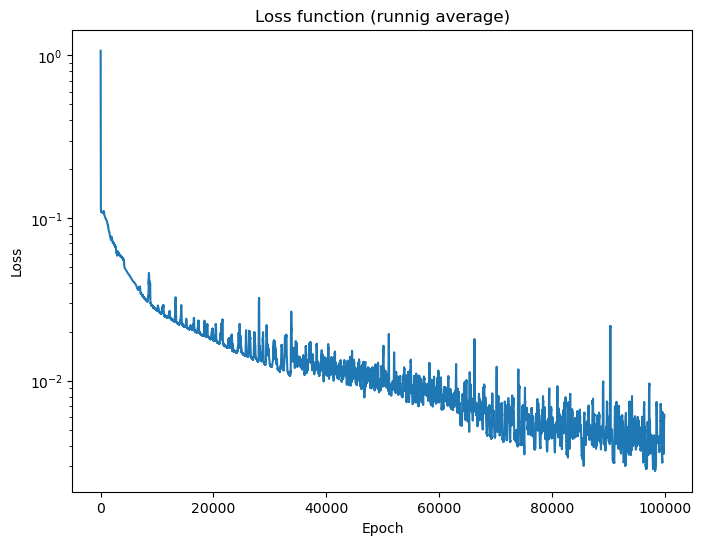

In [64]:
plot_running_average(loss_values, "Loss function (runnig average)", "total_loss")

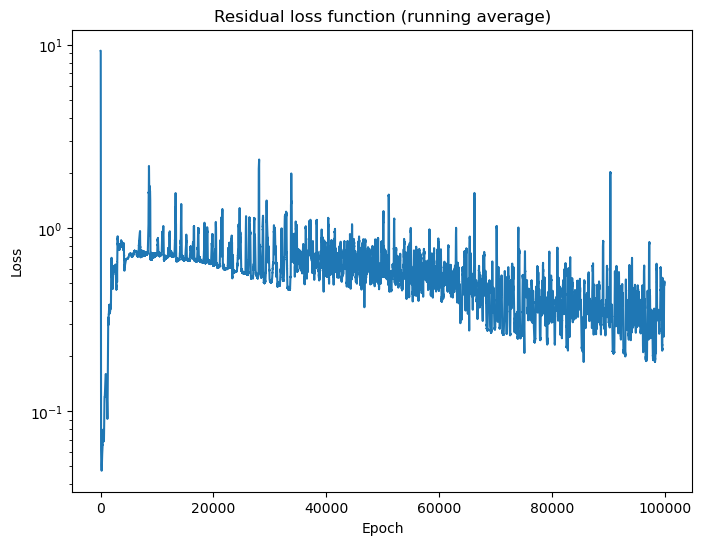

In [65]:
plot_running_average(residual_loss_values, "Residual loss function (running average)", "residual_loss")

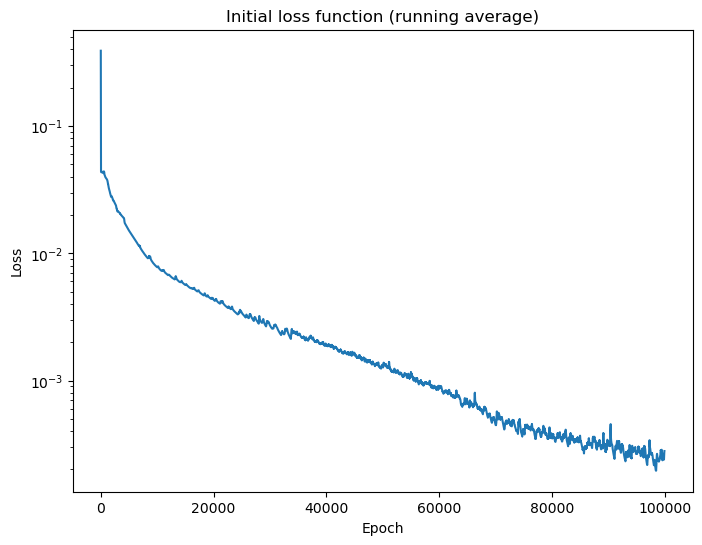

In [66]:
plot_running_average(initial_loss_values, "Initial loss function (running average)", "initial_loss")

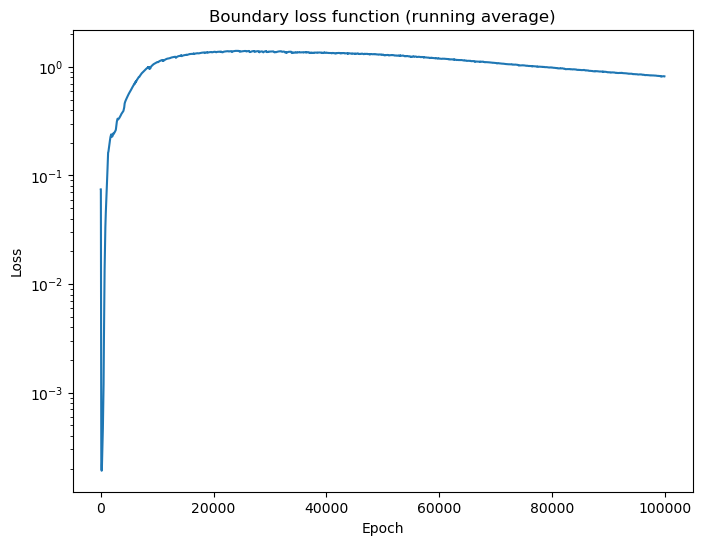

In [67]:
plot_running_average(boundary_loss_values, "Boundary loss function (running average)", "boundary_loss")

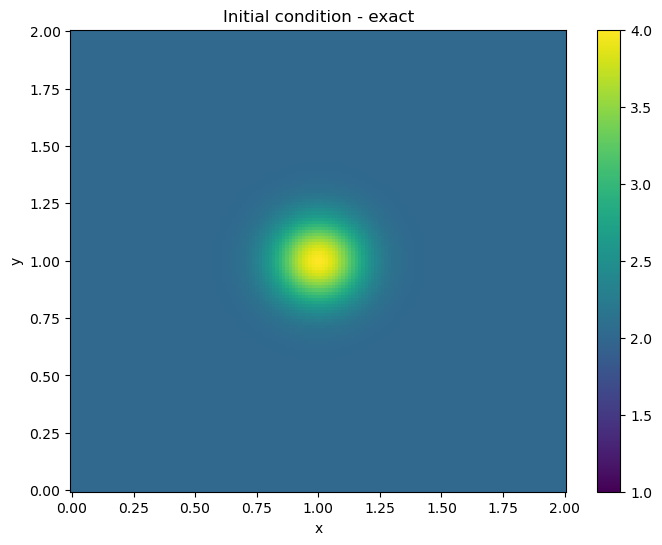

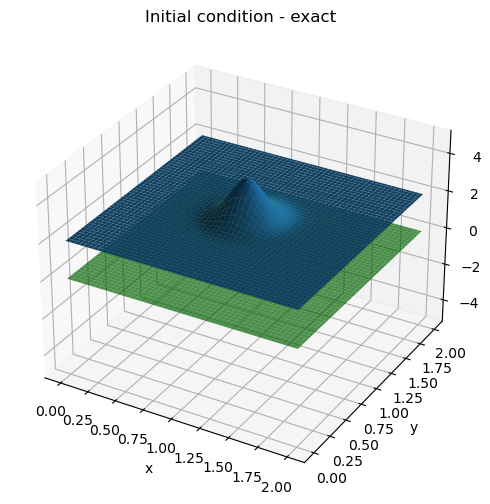

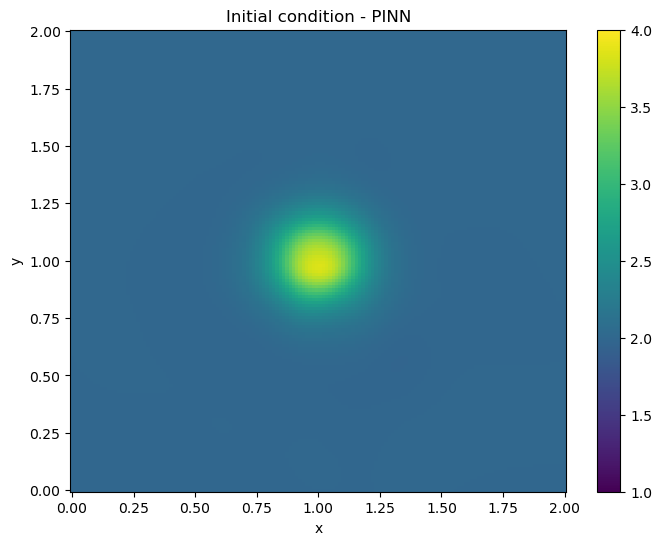

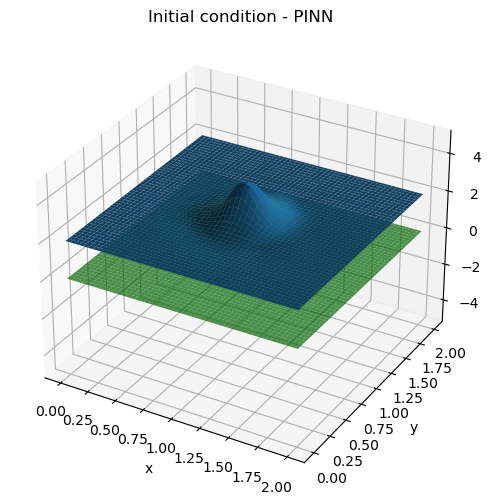

In [68]:
plot_intial_condition(x_domain=x_domain, 
                      y_domain=y_domain, 
                      t_domain=t_domain,
                      pinn=pinn,
                      initial_condition=initial_condition,
                      n_points=N_POINTS_PLOT,
                      length=LENGTH,
                      floor=floor)

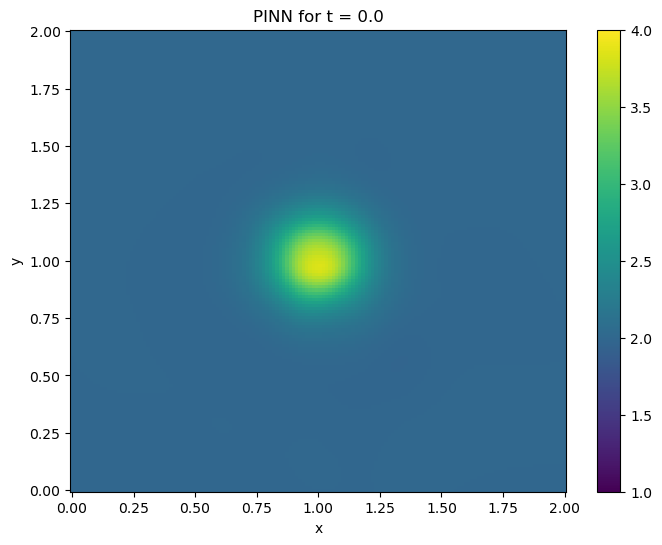

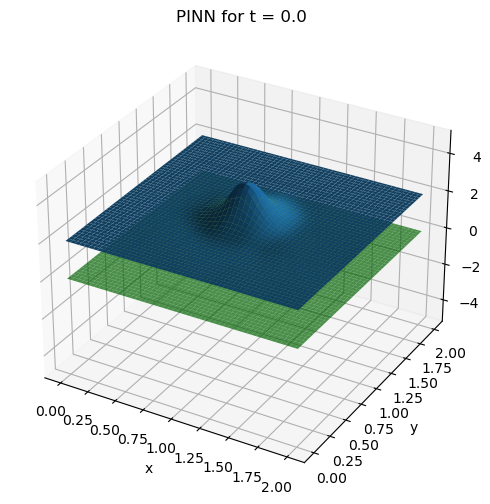

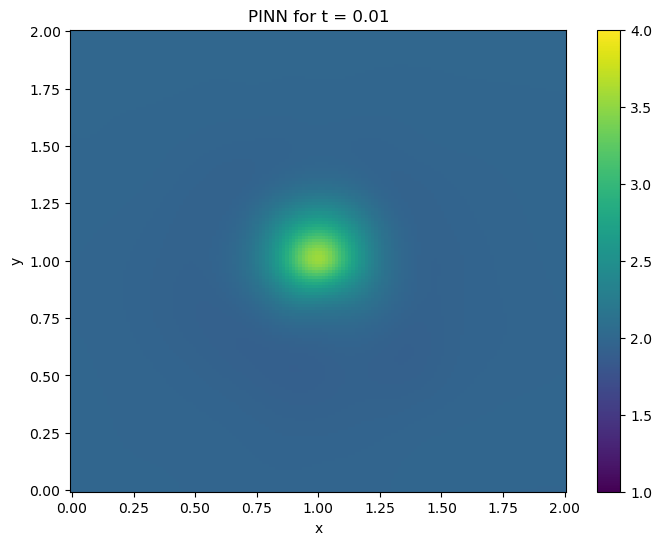

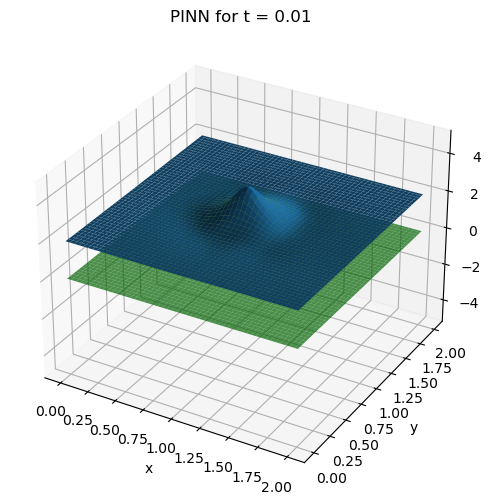

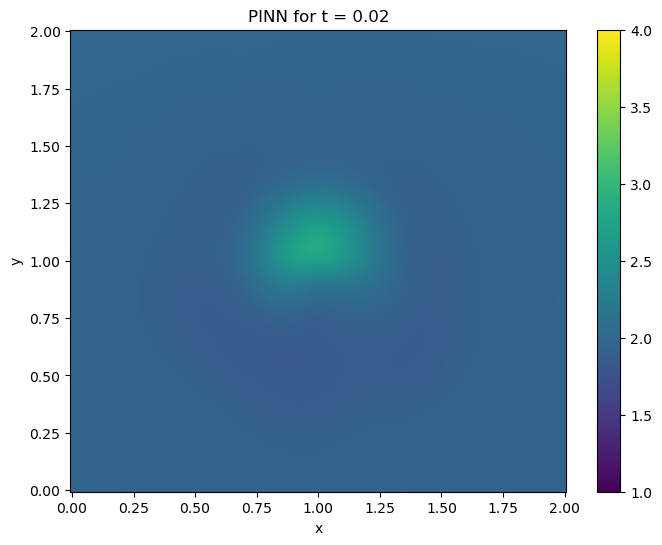

...

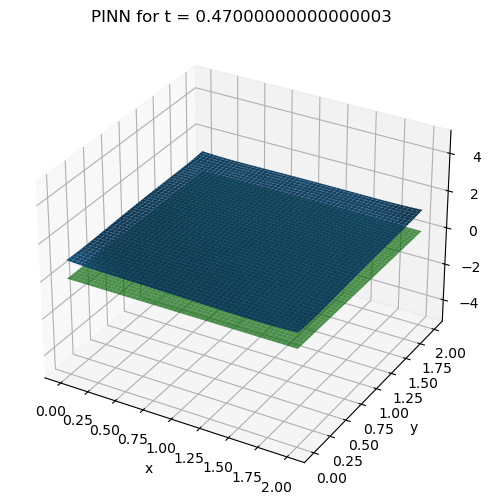

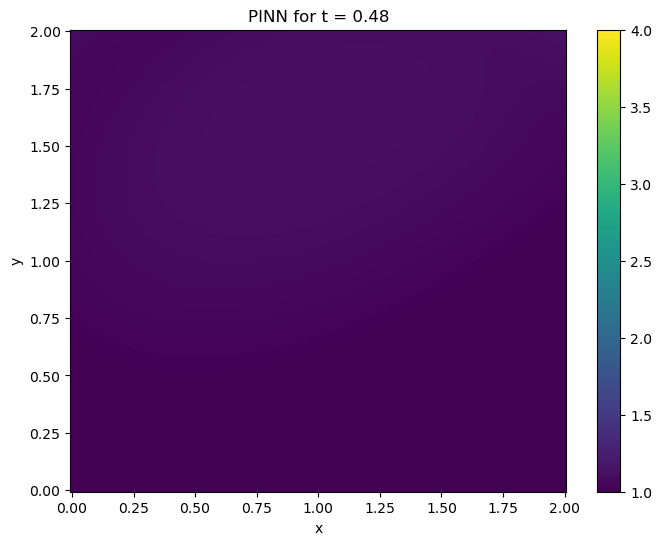

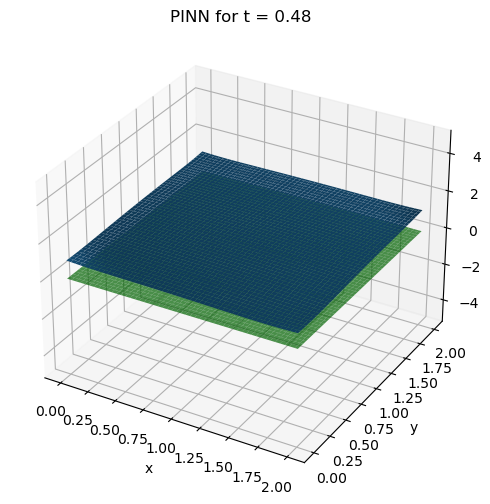

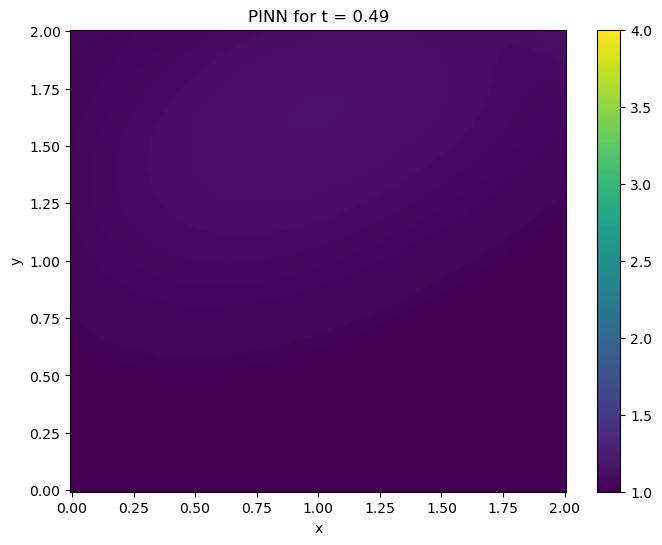

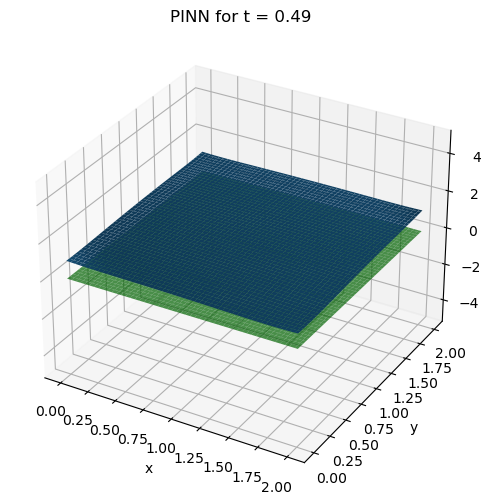

In [69]:
plot_simulation_by_frame(total_time=TOTAL_TIME,
                   x_domain=x_domain, 
                   y_domain=y_domain, 
                   t_domain=t_domain,
                   pinn=pinn,
                   n_points=N_POINTS_PLOT,
                   length=LENGTH,
                   floor=floor)

In [70]:
create_gif(TOTAL_TIME, title=f"tsunami_{RUN_NUM}")

In [71]:
date = datetime.now()

context: ReportContext = {
           'num': RUN_NUM,
           'date': date,
           'WEIGHT_RESIDUAL': WEIGHT_RESIDUAL, 
           'WEIGHT_INITIAL': WEIGHT_INITIAL, 
           'WEIGHT_BOUNDARY': WEIGHT_BOUNDARY,
           'LAYERS': LAYERS, 
           'NEURONS_PER_LAYER': NEURONS_PER_LAYER,
           'EPOCHS': EPOCHS, 
           'LEARNING_RATE': LEARNING_RATE,
           'total_loss': f"{losses[0]:.3E}",
           "residual_loss": f"{losses[1]:.3E}",
           "initial_loss": f"{losses[2]:.3E}",
           "boundary_loss": f"{losses[3]:.3E}",
           "img1": "./results/total_loss.png",
           "img2": "./results/residual_loss.png",
           "img3": "./results/initial_loss.png",
           "img4": "./results/boundary_loss.png",
    }

create_report(context,
              env_path='./',
              template_path='report_template.html',
              report_title=f"report_{RUN_NUM}.pdf")

### Evaluation

In [72]:
model = torch.load(f"./best_{RUN_NUM}.pt")

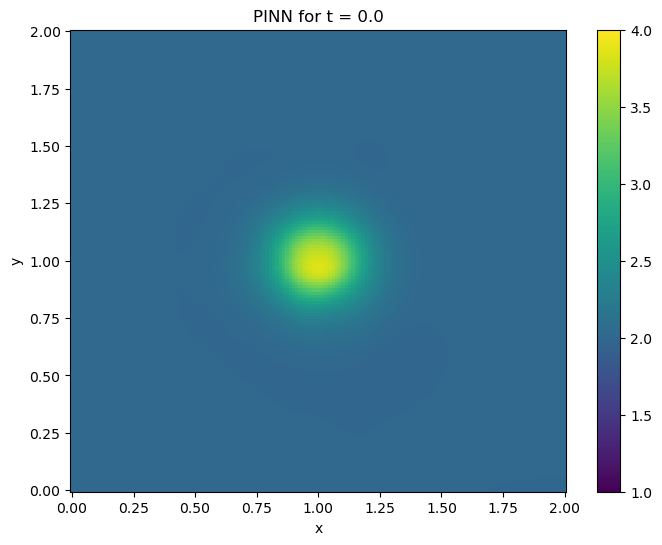

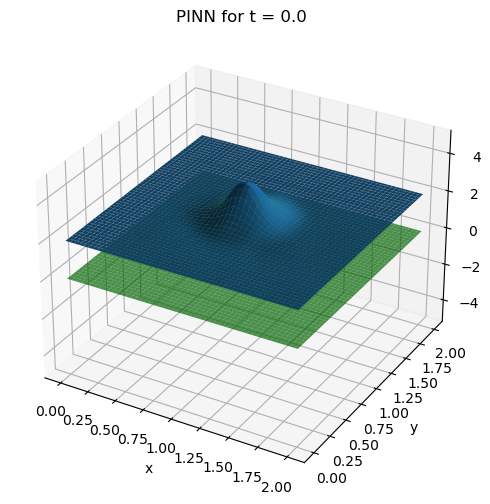

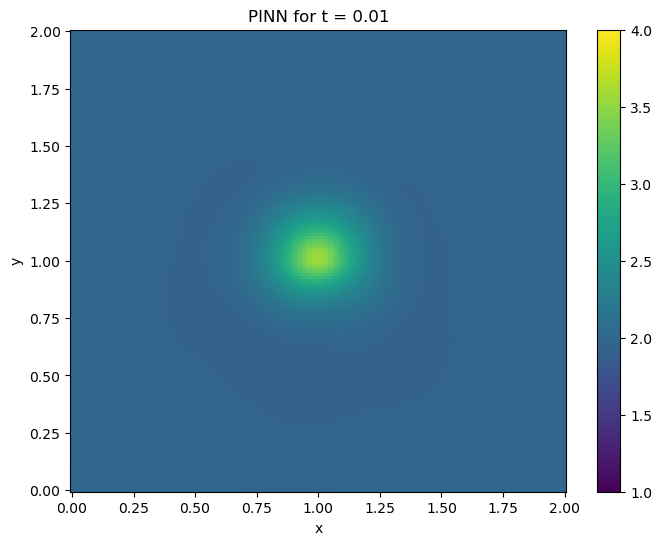

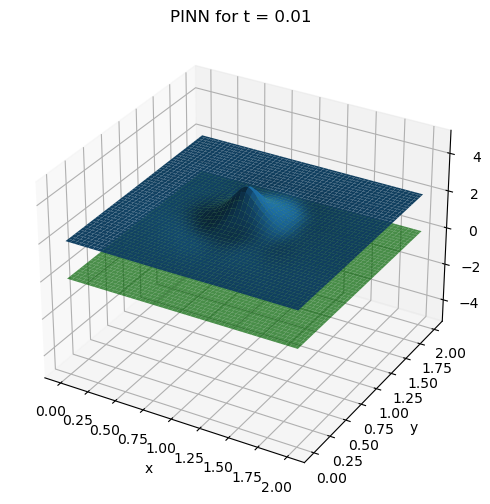

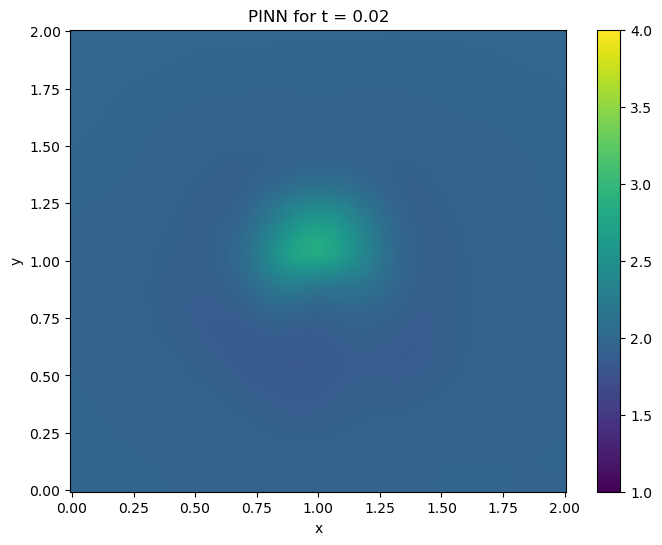

...

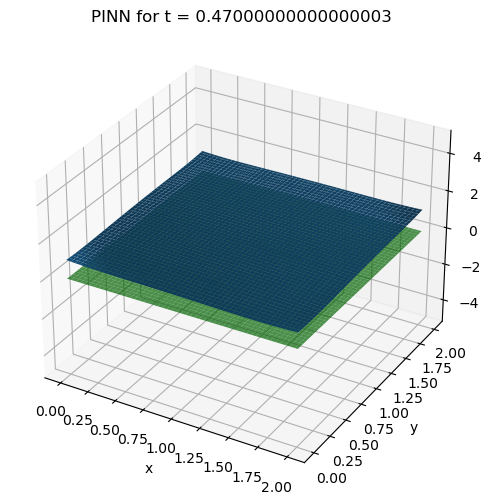

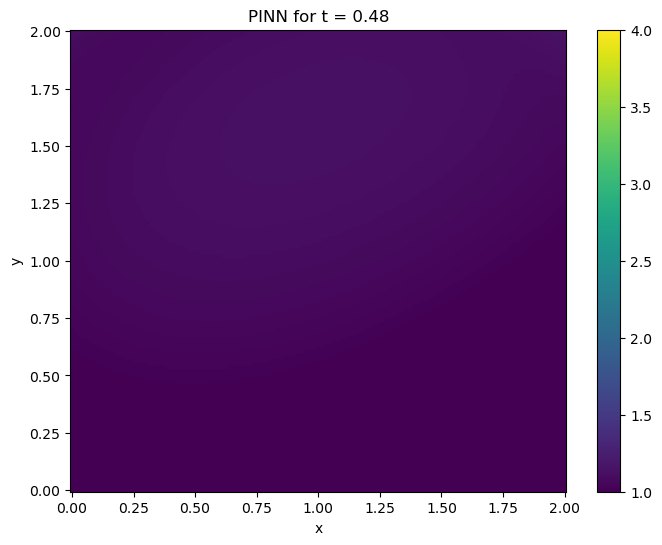

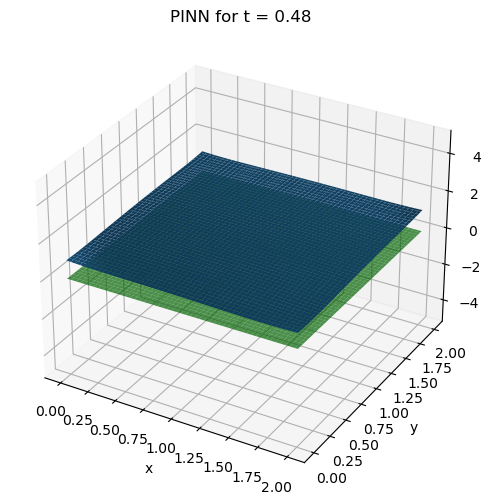

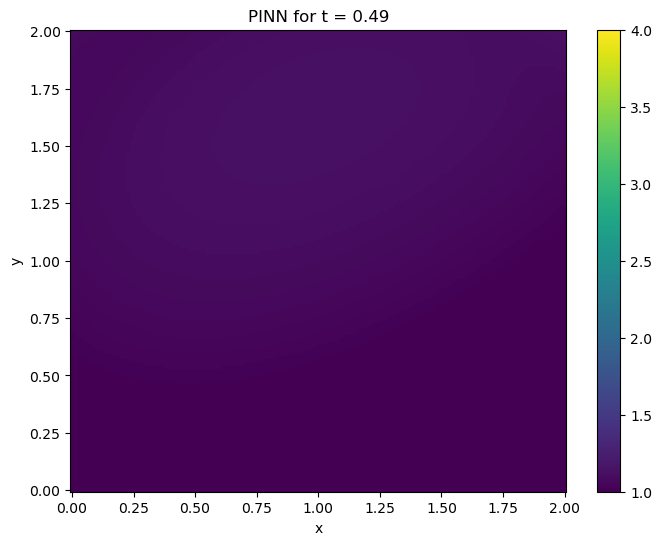

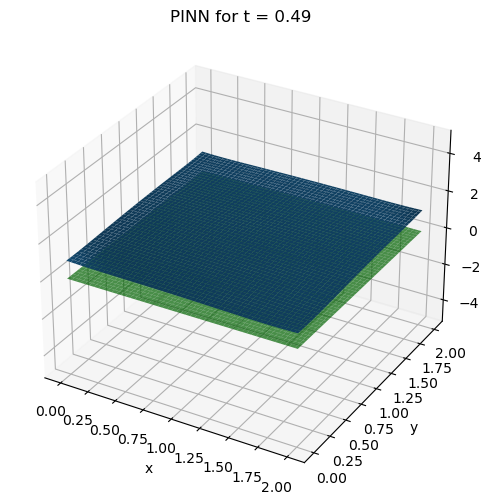

In [73]:
plot_simulation_by_frame(total_time=TOTAL_TIME,
                   x_domain=x_domain, 
                   y_domain=y_domain, 
                   t_domain=t_domain,
                   pinn=model,
                   n_points=N_POINTS_PLOT,
                   length=LENGTH,
                   floor=floor)

In [74]:
## Test

In [ ]:
import meshio
MESH_FILENAME = "valparaiso_square_UTM_translated_meshes/val_square_UTM_translated_0.inp"

def get_interior_points(x_domain, y_domain, t_domain, n_points, device = torch.device("cpu"), requires_grad=True):
    x_raw ,y_raw, z_raw = dump_points(MESH_FILENAME)
    t_raw = torch.linspace(t_domain[0], t_domain[1], steps=n_points)
    x_grid, t_grid = torch.meshgrid(x_raw, t_raw, indexing="ij")
    y_grid, _      = torch.meshgrid(y_raw, t_raw, indexing="ij")
    z_grid, _      = torch.meshgrid(z_raw, t_raw, indexing="ij")

    x = x_grid.reshape(-1, 1).to(device)
    y = y_grid.reshape(-1, 1).to(device)
    t = z_grid.reshape(-1, 1).to(device)
    z = t_grid.reshape(-1, 1).to(device)
    x.requires_grad = True
    y.requires_grad = True
    z.requires_grad = True
    t.requires_grad = True

    return x, y, z, t


def dump_points(filename):
    mesh = meshio.avsucd.read(filename)
    points = torch.tensor(mesh.points, dtype=torch.float32)
    x,y,z = points.transpose(0,1)
    #-> translate into [0,1]
    min_x = min(x)
    min_y = min(y)
    max_x = max(x)
    max_y = max(y)
    min_z = min(z)
    max_z = max(z)
    x = x - min_x
    y = y - min_y
#    z = z - min_z
    dx = max_x - min_x
    dy = max_y - min_y
    dz = max_z - min_z
    x = x / dx
    y = y / dy
    z = z / dz
    return x,y,z

In [ ]:
x,y,z,t = get_interior_points((0,1), (0,1), (0,1), N_POINTS, device)

In [ ]:
# import matplotlib.pyplot as plt

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
ax.scatter(x=x.cpu(), y=y.cpu(), z=z.cpu(), c=t.cpu().ravel(), cmap='viridis')

# Set labels
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_zlabel('Z-axis')

plt.show()